In [1]:
import sys
sys.path.append('../')
import numpy as np
from IPython.display import HTML

from rover_simulator.sensor import ImaginalStereoCamera
from rover_simulator.world import World
from rover_simulator.rover import DwaRover, RoverAnimation
from rover_simulator.history import SimpleHistory
from rover_simulator.collision_detector import CollisionDetector
from rover_simulator.navigation.sensing_planner import SimpleSensingPlanner
from rover_simulator.navigation.localizer import ImaginalLocalizer
from rover_simulator.navigation.controller import ArcPathController
from rover_simulator.navigation.mapper import GridMapper

In [2]:
ti = 0.1
world = World(time_interval=ti)
world.read_objects("../rover_simulator/examples/environment_simple.txt")

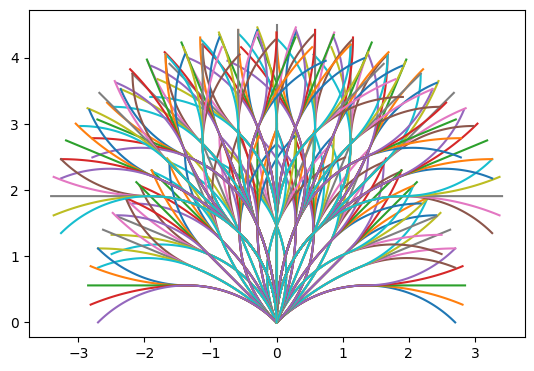

In [3]:
controller=ArcPathController(rover_r=0.5, v_range=[0, 0.5], w_range=[-np.pi/12, np.pi/12], branch_num=5, branch_depth=3, dt=ti)
controller.draw_path_primitives(dt=ti)

In [4]:
world.reset(reset_obstacles=False)

grid_width = 0.1
sensor = ImaginalStereoCamera(obstacles=world.obstacles, fov=np.pi/2)
mapper = GridMapper(grid_size=np.array([20, 20]), grid_width=grid_width, sensor=sensor, expand_dist=0.65)

start_pose = np.array([1.0, 2.0, 0.0])
goal_pos = np.array([13, 18])

history = SimpleHistory(sensor=sensor)
rover = DwaRover(
    start_pose, 0.5,
    sensor = sensor,
    mapper = mapper,
    controller=controller,
    localizer = ImaginalLocalizer(),
    collision_detector = CollisionDetector(world.obstacles),
    sensing_planner = SimpleSensingPlanner(sense_interval_distance=3.0, sense_interval_angle=np.pi/6),
    history=history,
    color="black",
    waypoint_pos=goal_pos
)

world.append_rover(rover)

In [5]:
world.simulate(500)

Simulation:   0%|          | 0/500 [00:00<?, ?it/s]

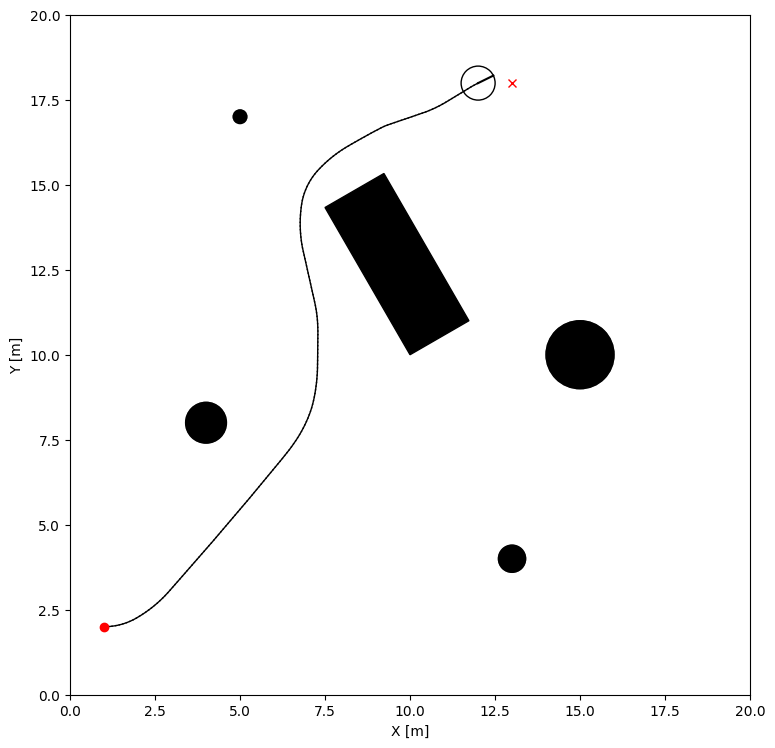

In [6]:
world.draw([0, 20], [0, 20], start_pos=start_pose, goal_pos=goal_pos)

In [7]:
world.animate(xlim=[0, 20], ylim=[0, 20])
HTML(world.ani.to_jshtml())

  0%|          | 0/500 [00:00<?, ?it/s]

Animation size has reached 21006464 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
